In [1]:
!pip install essentia

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.7/13.7 MB 18.7 MB/s eta 0:00:00


In [2]:
from essentia.standard import PredominantPitchMelodia, EqloudLoader
import matplotlib.pyplot as plt
import librosa
import librosa.display
import numpy as np
from IPython.display import Audio
from scipy.ndimage import gaussian_filter1d

In [3]:
sr = 44100
H = 441
M = 4096
N = 4096

In [6]:
!ls

sample_data  vocals.wav


(10337,)


(0.0, 1000.0)

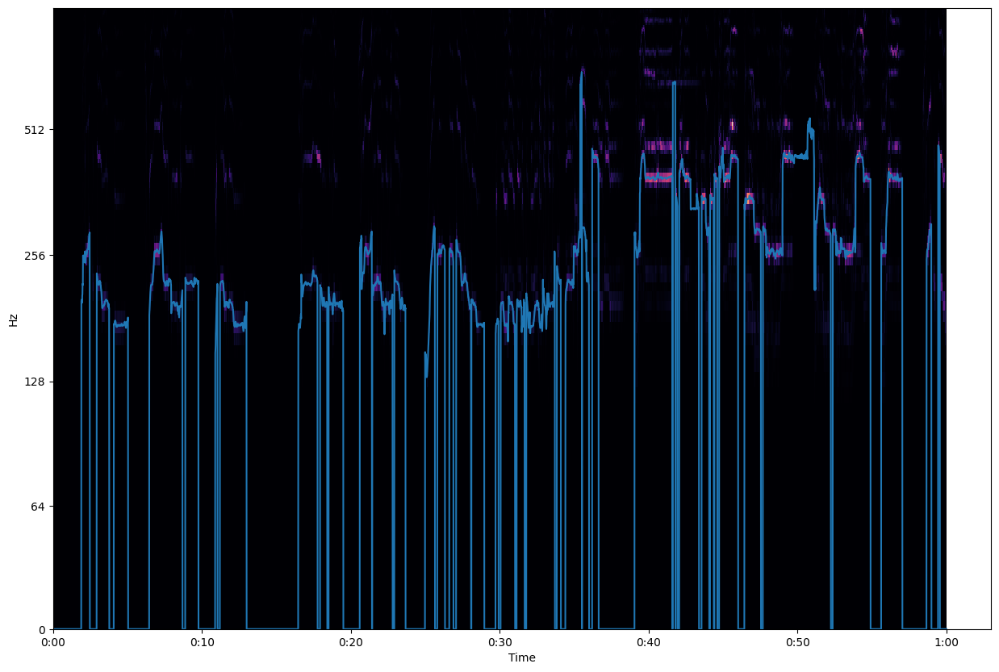

In [7]:
loader = EqloudLoader(filename='vocals.wav', sampleRate=44100)
duration = 60
audio = loader()[0*44100:duration*44100]

pitch_extractor = PredominantPitchMelodia(frameSize=4096, hopSize=256, voicingTolerance = 0.5)
pitch_values, pitch_confidence = pitch_extractor(audio)

pitch_values = pitch_values * (pitch_confidence>0.006) * (pitch_values < 750) * (pitch_values > 75)
print(pitch_values.shape)

X = librosa.stft(audio, n_fft=4096, hop_length=256, win_length=4095)
X_mag = np.abs(X)

plt.figure(1, figsize = (15,10))
librosa.display.specshow(X_mag, n_fft=4096, sr = 44100, hop_length=256, x_axis='time', y_axis='log')
plt.plot(np.linspace(0,duration+0.0001, len(pitch_values)), pitch_values)
plt.ylim(0,1000)

In [25]:
def fillGaps(f0, fs = 44100, time = 400):
    count = 0
    time = time//(fs/256)
    value = 0
    f0_new = f0
    for i in range(len(f0)):
        if(f0[i]==0):
            count+=1
        else:
            if(count>=time):
                count = 0
            else:
                f0_new[i-count:i] = np.ones(count)*value
                count = 0
                value = 0
        if(i!=len(f0)-1 and f0[i+1]==0 and count==0):
            value = f0[i]
    return f0_new

(0.0, 1000.0)

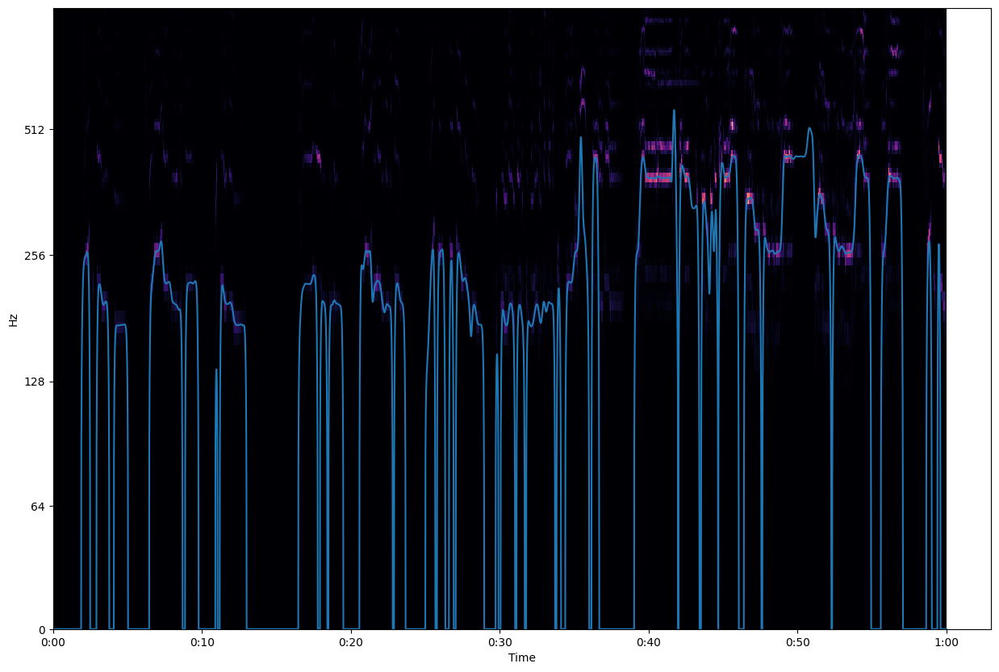

In [40]:
pitch_values = gaussian_filter1d(fillGaps(pitch_values), 2) * (pitch_values > 75)

plt.figure(1, figsize = (15,10))
librosa.display.specshow(X_mag, n_fft=4096, sr = 44100, hop_length=256, x_axis='time', y_axis='log')
plt.plot(np.linspace(0,duration+0.0001, len(pitch_values)), pitch_values)
plt.ylim(0,1000)

In [41]:
def sinewaveSynth(freqs, amp, H, fs):
	"""
	Synthesis of one sinusoid with time-varying frequency
	freqs, amps: array of frequencies and amplitudes of sinusoids
	H: hop size, fs: sampling rate
	returns y: output array sound
	"""

	t = np.arange(H)/float(fs)                              # time array
	lastphase = 0                                           # initialize synthesis phase
	lastfreq = freqs[0]                                     # initialize synthesis frequency
	y = np.array([])                                        # initialize output array
	for l in range(freqs.size):                             # iterate over all frames
		if ((lastfreq==0) and (freqs[l]==0)):                     # if 0 freq add zeros
			A = np.zeros(H)
			freq1 = np.zeros(H)
		elif ((lastfreq==0) and (freqs[l]>0)):                    # if starting freq ramp up the amplitude
			A = np.arange(0, amp[l], amp[l]/H)
			freq1 = np.ones(H)*freqs[l]
		elif ((lastfreq>0) and (freqs[l]>0)):                     # if freqs in boundaries use both
			A = np.ones(H)*amp[l]
			if (lastfreq==freqs[l]):
				freq1 = np.ones(H)*lastfreq
			else:
				freq1 = np.arange(lastfreq, freqs[l], (freqs[l]-lastfreq)/H)
		elif ((lastfreq>0) and (freqs[l]==0)):                    # if ending freq ramp down the amplitude
			A = np.arange(amp[l],0,-amp[l]/H)
			freq1 = np.ones(H)*lastfreq
		else:
			freq1 = np.zeros(H)
			A = np.zeros(H)
		if freq1.size > t.size:
			freq1 = freq1[:t.size]
		phase = 2*np.pi*freq1*t+lastphase                      # generate phase values
		yh = A * np.cos(phase)                                # compute sine for one frame
		lastfreq = freqs[l]                                   # save frequency for phase propagation
		lastphase = np.remainder(phase[H-1], 2*np.pi)         # save phase to be use for next frame
		y = np.append(y, yh)                                  # append frame to previous one
	return y

In [12]:
Audio(audio, rate = 44100)

In [13]:
sine = sinewaveSynth(pitch_values, np.ones_like(pitch_values)*0.01, 256, 44100)
Audio(sine, rate = 44100)

In [42]:
def convertFreq2Midi(
        freq_in_hz
    ):
    fa = 440
    try:
        a = len(freq_in_hz)
        res = np.zeros_like(freq_in_hz)
        for i, freq in enumerate(freq_in_hz):
            if freq != 0:
                res[i] = 12 * np.log2(freq / fa) + 69
            else:
                res[i] = 0
        return res
    except:
        if freq_in_hz != 0:
            return 12 * np.log2(freq_in_hz / fa) + 69
        else:
            return 0

In [43]:
midi_values = convertFreq2Midi(pitch_values)
round_midi_values = (2**((np.round(midi_values)-69)/12))*440

(0.0, 1000.0)

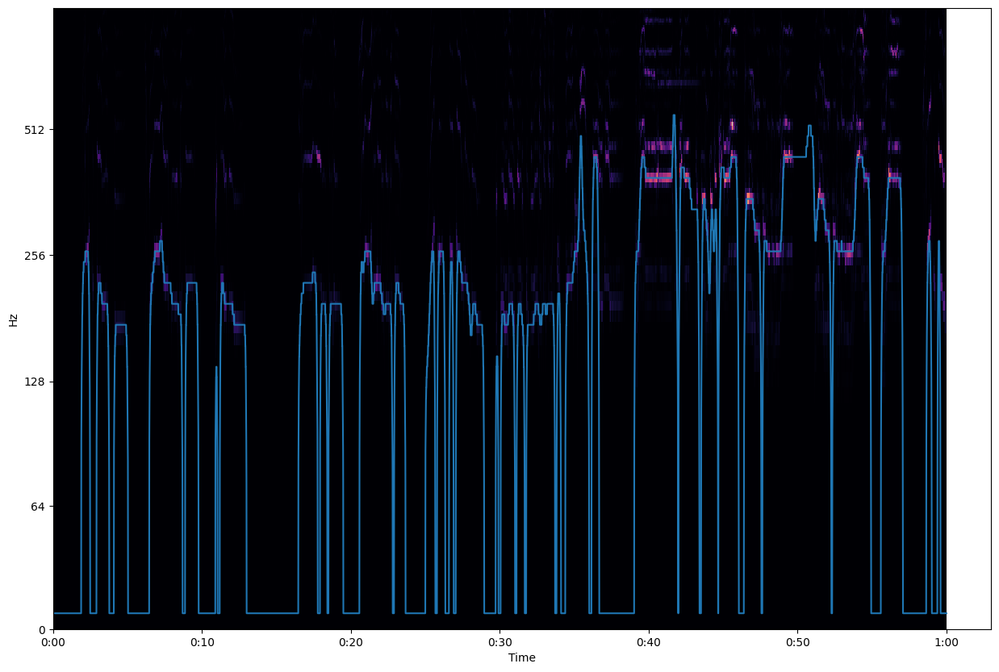

In [44]:
plt.figure(1, figsize = (15,10))
librosa.display.specshow(X_mag, n_fft=4096, sr = 44100, hop_length=256, x_axis='time', y_axis='log')
plt.plot(np.linspace(0,duration+0.0001, len(pitch_values)), round_midi_values)
plt.ylim(0,1000)

In [46]:
midi_values

array([0., 0., 0., ..., 0., 0., 0.], dtype=float32)

In [120]:
def removeNoisyMidi(midi, threshold_num_samples = 20):
  # midi: Rounded to int
  idx = 0
  temp = midi
  while(idx<len(midi)):
    flag = False
    counter = 1
    for notes in midi[idx+1:idx+threshold_num_samples]:
      if notes!=midi[idx]:
        break
      counter+=1
    if counter == threshold_num_samples:
      idx+=threshold_num_samples
      flag = True
    elif not flag:
      temp[idx:idx+counter] = np.zeros(counter)
      idx+=counter;
    else:
      idx+=counter
  return temp

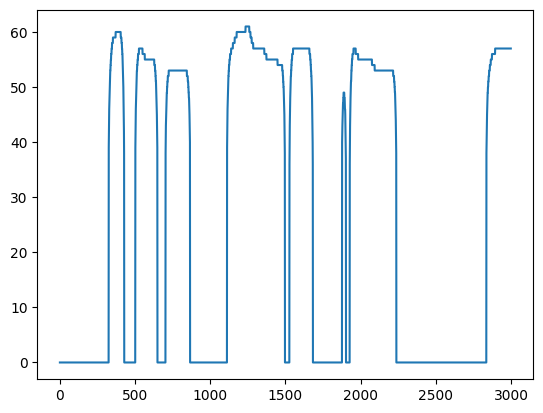

In [121]:
plt.plot(np.round(midi_values[:3000]))

In [122]:
def fillMidiGaps(f0, fs = 44100, time_stamps = 40):
    count = 0
    value = 0
    f0_new = f0
    for i in range(len(f0)):
        if(f0[i]==0):
            count+=1
        else:
            if(count>=time_stamps):
                count = 0
            else:
                f0_new[i-count:i] = np.ones(count)*value
                count = 0
                value = 0
        if(i!=len(f0)-1 and f0[i+1]==0 and count==0):
            value = f0[i]
    return f0_new

In [123]:
Audio(audio, rate = 44100)

In [124]:
cleaned_midi = fillMidiGaps(removeNoisyMidi(np.round(midi_values)))
rounded_cleaned_midi = (2**((np.round(cleaned_midi)-69)/12))*440

(0.0, 1000.0)

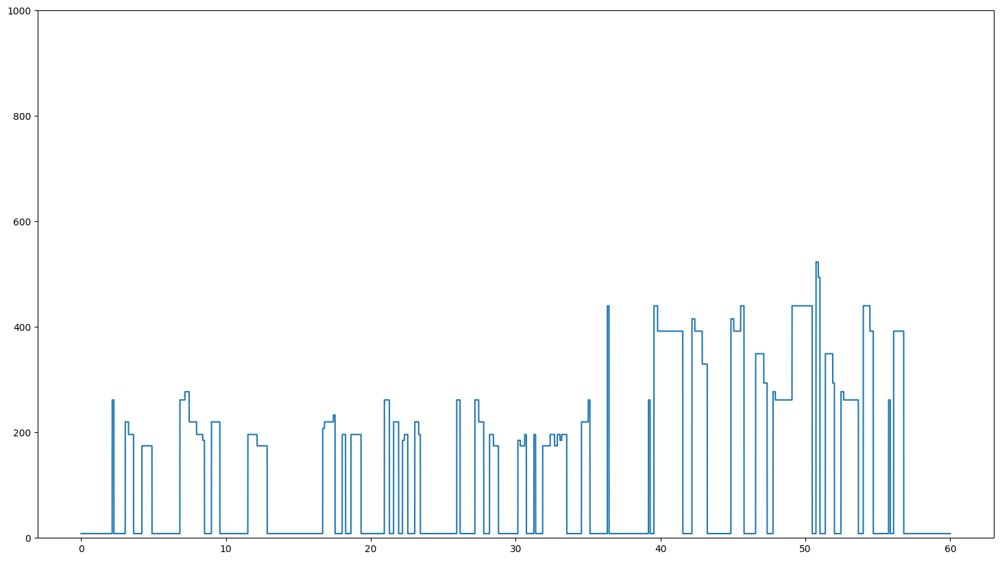

In [125]:
plt.figure(figsize = (18,10))
plt.plot(np.linspace(0,duration+0.0001, len(midi_values)), rounded_cleaned_midi)
plt.ylim(0,1000)